## **To recreate study results please load package versions found in main_requirements.txt**

## **Load packages and setup enviroment**

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib
import math
import seaborn as sns
import os
# %config IPCompleter.greedy=True
%load_ext autoreload
%autoreload 2

sc.settings.verbosity = 0
sc.logging.print_header()
sns.set_context("paper")

scanpy==1.10.3 anndata==0.10.9 umap==0.5.7 numpy==1.26.4 scipy==1.13.1 pandas==2.2.3 scikit-learn==1.6.1 statsmodels==0.14.4 igraph==0.8.3 pynndescent==0.5.13


In [2]:
# import local module containing misc code, helps keep notebooks clean from commonly used functions
import new_misc_code as nmc

In [3]:
import warnings
warnings.simplefilter( action="ignore", category=FutureWarning)

## **Load count data**

In [4]:
# read in count matrices post nuclei and gene quality control
adata = sc.read( "../data/Processed_data_RNA-all_full-counts-and-downsampled-CPM.h5ad")

In [5]:
# read in adata post clustering and dev-traj assignment
adata_GABA = sc.read_h5ad( "../data/Processed_data_RNA-gaba_full-counts-and-downsampled-CPM.h5ad")

In [6]:
adata.obs_names.values

array(['AAACCTGAGAGTCGGT-RL1612_34d_v2', 'AAACCTGAGCCGCCTA-RL1612_34d_v2',
       'AAACCTGAGTCGAGTG-RL1612_34d_v2', ...,
       'TTTGTTGGTAAGGTCG-RL2132_25yr_v3',
       'TTTGTTGGTTCGGCTG-RL2132_25yr_v3',
       'TTTGTTGTCGTCCTCA-RL2132_25yr_v3'], dtype=object)

In [7]:
adata.shape
adata

AnnData object with n_obs × n_vars = 154748 × 26747
    obs: 'batch', 'RL#', 'age', 'chem', 'concat_id', 'numerical_age', 'stage_id', 'Sex', 'Race', 'PMI', 'Brain Regions*', 'Cause of Death', 'ICD-10 Code', 'ICD-10 category', 'Oxygen/No Oxygen', 'Date-of-Collection', 'Collection_year', 'Library Prep Date', 'Library Prep Lot', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'doublet_score', 'log10_gene_counts', 'log10_UMI_counts', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden', 'mat/dev', 'cell_type', 'major_clust', 'sub_clust', 'combined-leiden', 'Astro_GFAP_dev-traj', 'Astro_SLC1A2_dev-traj', 'L2_CUX2_LAMP5_dev-traj', 'L3_CUX2_PRSS12_dev-traj', 'L4_RORB_LRRK1_dev-traj', 'L4_RORB_MET_dev-traj', 'L4_RORB_MME_dev-traj', 'L5-6_THEMIS_CNR1_dev-traj', 'L5-6_THEMIS_NTNG2_dev-traj', 'L5-6_TLE4_HTR2C_dev-traj', 'L5-6_TLE4_SCUBE1_dev-traj', 'L5-6_TLE4_SORCS1_dev-traj', 'Micro_dev-traj', 'OPC_dev-traj', 'OPC_MBP_dev-traj', 'Oligo_dev-traj', 'Vas_CLDN5_

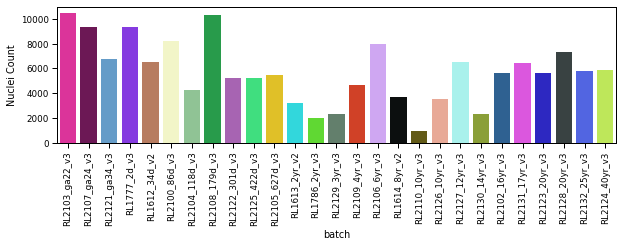

In [8]:
plt.figure(figsize=(10, 2.5))
plt.xticks(rotation=90)

sns.countplot(
    x='batch',
    data=adata.obs,
    order=adata.uns['batch_order'],
    palette=adata.uns['batch_colors_dict']
)

plt.ylabel("Nuclei Count")
plt.show()

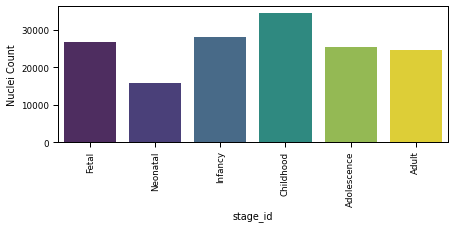

In [9]:
plt.figure(figsize=(7, 2.5))
plt.xticks(rotation=90)

sns.countplot(
    x='stage_id',
    data=adata.obs,
    order=adata.uns['stage_order'],
    palette=adata.uns['stage_colors_dict']
)

plt.ylabel("Nuclei Count")
plt.show()

## **Select highly variable genes**

In [10]:
high_adata = adata[:,adata.var.highly_variable.values]
high_adata.shape

(154748, 4999)

## **PCA Plots**

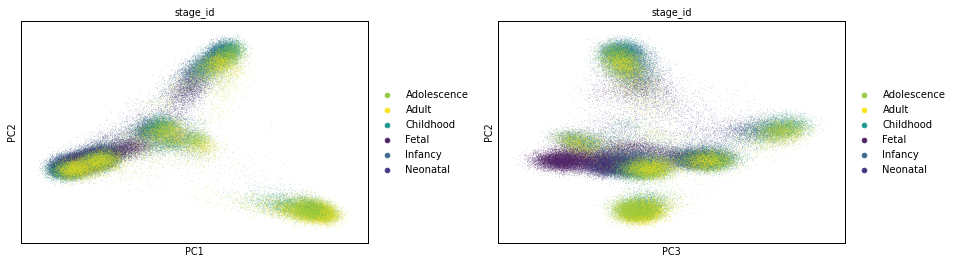

In [11]:
sc.pl.pca( high_adata, color=['stage_id'], components=['1,2','3,2'], legend_fontsize=10, wspace=0.25)

## **Plot UMAP**

Since scanpy doesn't currently have an option to fully randomize order of observations for plotting, create a randomly ordered adata for plotting. Setting *sort_order=False* will still plot observations in order of indices, i.e. order batches were concated. 

In [12]:
# subsampling the full adata will reproduce adata with random order
plt_adata = sc.pp.subsample( high_adata, fraction=1.0, random_state=0, copy=True)

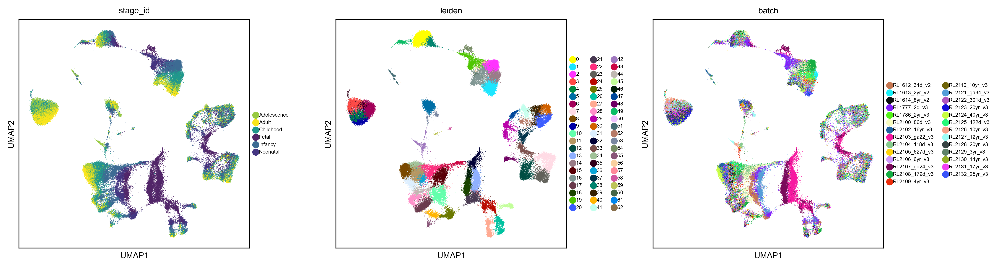

In [13]:
sc.settings.set_figure_params( dpi=200, fontsize=8)
sc.pl.umap( plt_adata, color=['stage_id','leiden','batch'], legend_fontsize=5, wspace=0.25)
# sc.pl.umap( plt_adata, color=['stage_id','batch'], legend_fontsize=5, wspace=0.25)

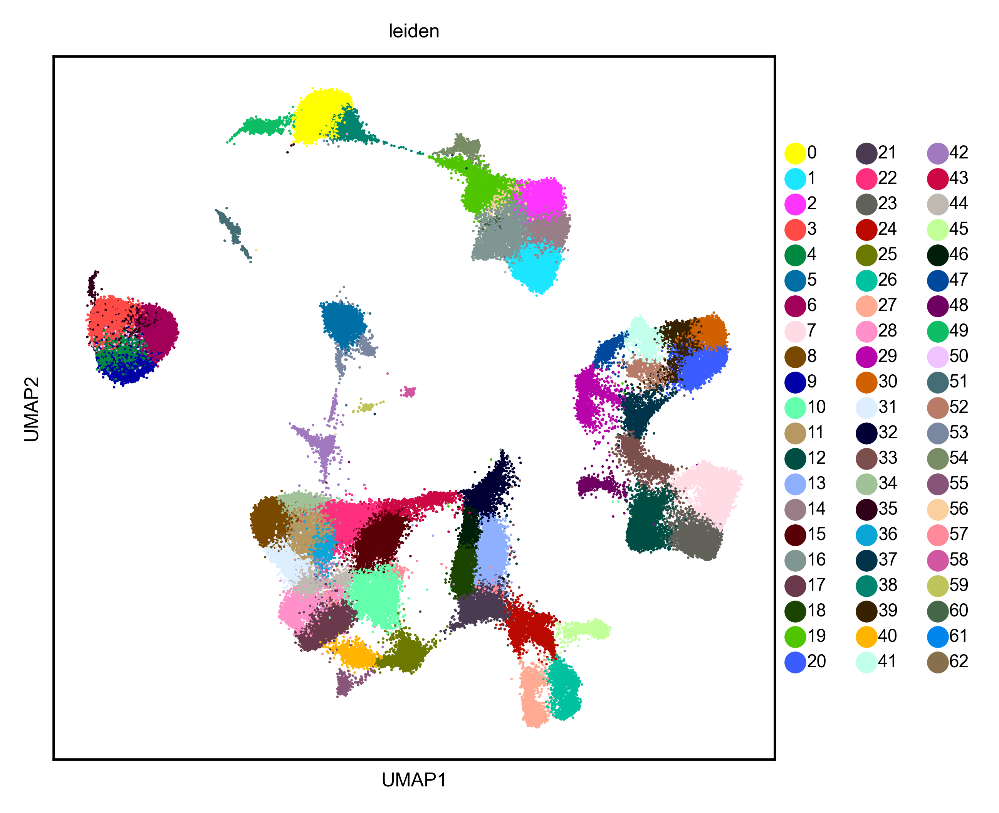

In [14]:
# settings for manuscript plots
feat = 'leiden'
sc.settings.set_figure_params( dpi=300, fontsize=6)
ax = sc.pl.umap( plt_adata, color=feat, size=2.5, sort_order=False, show=False)
plt.show()
#plt.savefig( f"{fig_path}whole-tissue_UMAP-{feat}.png", format='png', dpi=300, bbox_inches='tight')

## **Prepare adata object for Gene Overlay Plots - with full count matrix**

In [15]:
# re-calculate umi and gene counts per nuclei
sc.pp.calculate_qc_metrics( adata, percent_top=None, inplace=True)
# scale to CPM
sc.pp.normalize_total( adata, target_sum=1e6, inplace=True)
# VST
sc.pp.log1p( adata, copy=False)
# randomize order again
plt_adata = sc.pp.subsample( adata, fraction=1.0, random_state=0, copy=True) 

Set default figure parameters (for plot appearance)

In [20]:
# Set default figure parameters (still useful for appearance)
sc.settings.set_figure_params(dpi=150, fontsize=6)

# Show UMAP overlays directly in the notebook instead of saving
def plot_show_overlays(genes, title='', adata=plt_adata, pt_size=5, layer=None):
    sc.pl.umap(
        adata,
        color=genes,
        title=genes,             # Show actual gene names as subplot titles
        layer=layer,             # Optional: pull from layers like "ds_norm_cts"
        size=pt_size,
        sort_order=False,
        cmap='magma',
        show=True
    )
    
###########################################################################
#### code for saving figures (rather than plotting in jupyter notebook)####
# def plot_save_overlays( genes, title, adata=plt_adata, pt_size=5):
#    ax = sc.pl.umap( adata, color=genes, size=pt_size, sort_order=False, cmap='magma', show=False)
#    plt.savefig( f"{fig_path}whole-tissue_UMAP-{title}.png", format='png', bbox_inches='tight')
#    return

Principle Neuron Markers

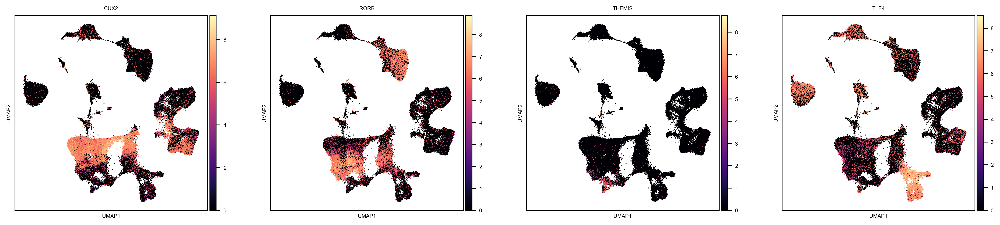

In [21]:
pn_genes = ['CUX2','RORB','THEMIS','TLE4']
plot_show_overlays( pn_genes, 'PN_genes')

Inhibitory Neruon Markers

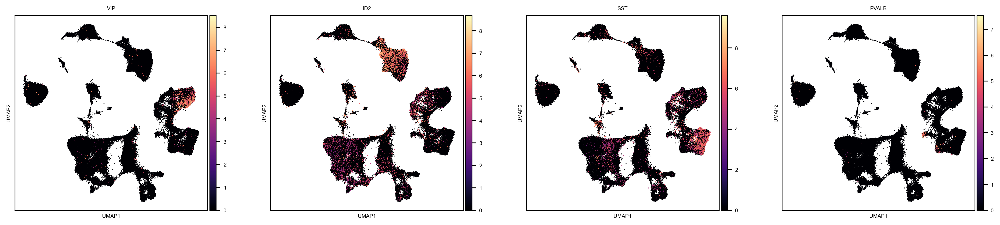

In [22]:
in_genes = ['VIP','ID2','SST','PVALB']
plot_show_overlays( in_genes, 'IN_genes')

Glia and Vascular Markers

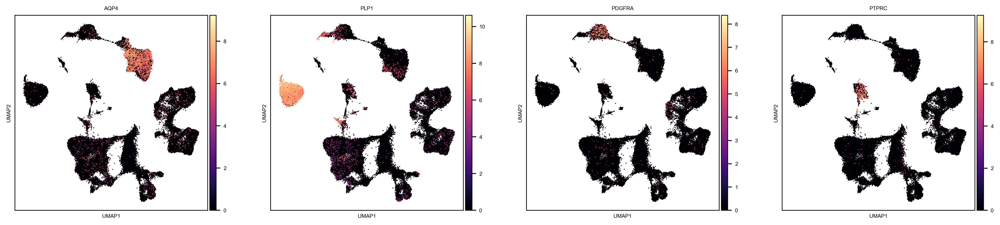

In [23]:
gv_genes = ['AQP4','PLP1','PDGFRA','PTPRC']
plot_show_overlays( gv_genes, 'Glia-Vas_genes')

## **Check manually annotated cluster data**

In [24]:
adata.uns['wt_clust_data'].head()

,mat/dev,cell_type,major_clust,sub_clust,dev_clust,downstream_dev_clusts
leiden,,,,,,
0,mat,Non-Neu,OPC,OPC,OPC,OPC_dev
1,mat,Non-Neu,Astro,Astro_SLC1A2,Astro_SLC1A2,"Astro_SLC1A2_dev,Astro_dev"
2,dev,Non-Neu,Astro,Astro_dev-1,Astro_dev,root
3,mat,Non-Neu,Oligo,Oligo_mat,Oligo,"Oligo,OPC_MBP"
4,mat,Non-Neu,Oligo,Oligo-1,Oligo,"Oligo,OPC_MBP"


In [25]:
adata.obs.head()

,batch,RL#,age,chem,concat_id,numerical_age,stage_id,Sex,Race,PMI,...,mj_dev_traj_VIP,mj_dev_traj_OPC,mj_dev_traj_PV,mj_dev_traj_PV_SCUBE3,mj_dev_traj_ID2,mj_dev_traj_Oligo,mj_dev_traj_LAMP5_NOS1,mj_dev_traj_Micro,mj_dev_traj_Vas,mj_dev_traj_Poor-Quality
AAACCTGAGAGTCGGT-RL1612_34d_v2,RL1612_34d_v2,RL1612,34d,v2,0,0.093151,Neonatal,M,AA,5,...,None,None,None,None,None,None,None,None,None,None
AAACCTGAGCCGCCTA-RL1612_34d_v2,RL1612_34d_v2,RL1612,34d,v2,0,0.093151,Neonatal,M,AA,5,...,None,None,None,None,None,None,None,None,None,None
AAACCTGAGTCGAGTG-RL1612_34d_v2,RL1612_34d_v2,RL1612,34d,v2,0,0.093151,Neonatal,M,AA,5,...,None,None,None,None,None,None,None,None,None,None
AAACCTGAGTGAACAT-RL1612_34d_v2,RL1612_34d_v2,RL1612,34d,v2,0,0.093151,Neonatal,M,AA,5,...,None,None,None,None,None,None,None,None,None,None
AAACCTGCAAGGACTG-RL1612_34d_v2,RL1612_34d_v2,RL1612,34d,v2,0,0.093151,Neonatal,M,AA,5,...,None,None,None,None,None,None,None,None,None,None


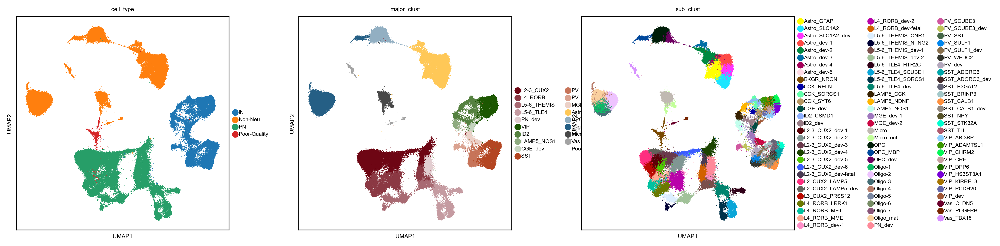

In [26]:
ax = sc.pl.umap( adata, color=['cell_type','major_clust','sub_clust'], size=2.5, sort_order=False, show=False)

### **Visualize GABA Inhibitory Neurons**

In [27]:
high_adata_G = adata_GABA[:,adata_GABA.var.highly_variable.values]
high_adata_G.shape

(27561, 4000)

# *PCA*

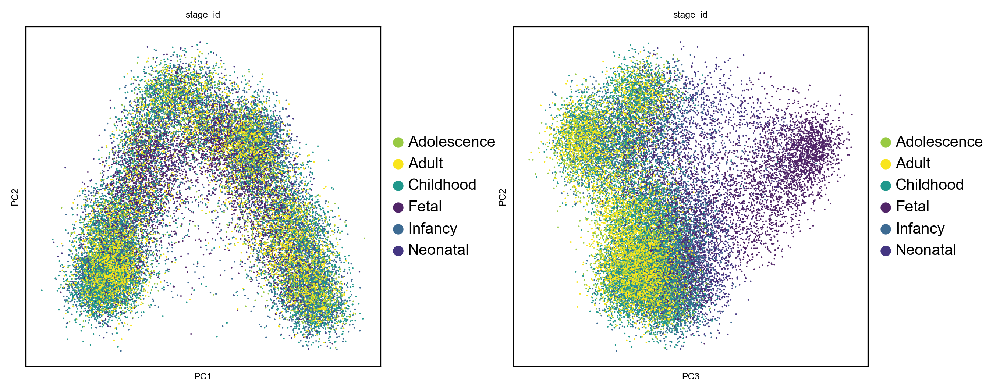

In [28]:
sc.pl.pca( high_adata_G, color=['stage_id'], components=['1,2','3,2'], legend_fontsize=10, wspace=0.25)

# *UMAP*

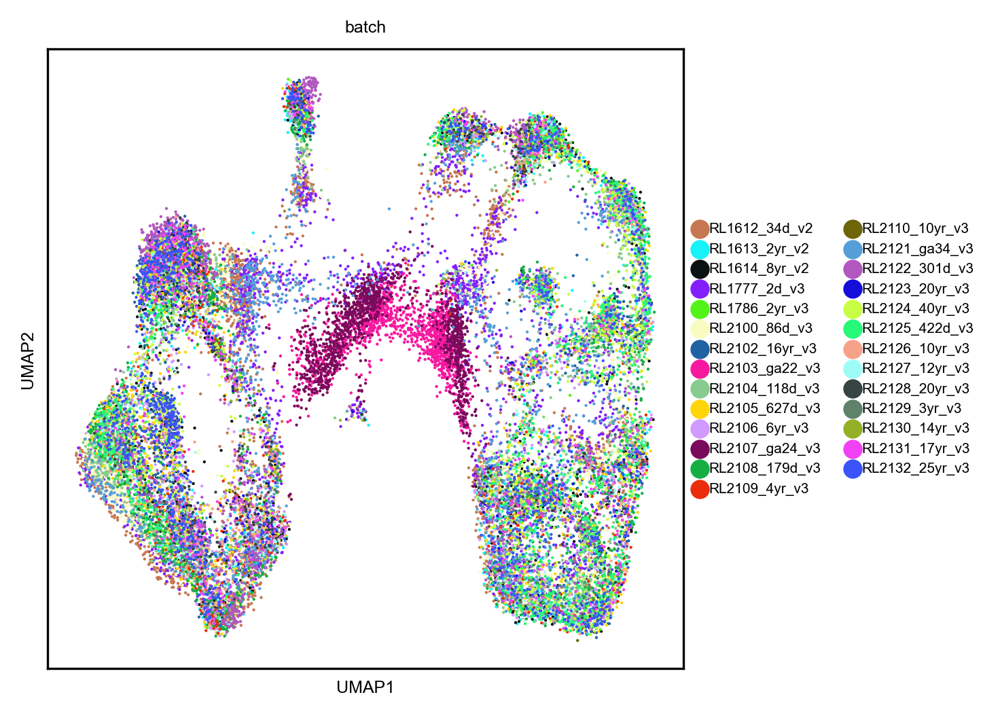

In [29]:
sc.pl.umap( high_adata_G, color=['batch'], legend_fontsize=5, wspace=0.25)

## **Misc Feature Plots**

Since scanpy doesn't currently have an option to fully randomize order of observations for plotting, create a randomly ordered adata for plotting. Setting *sort_order=False* will still plot observations in order of indices, i.e. order batches were concated. 

In [30]:
# subsampling the full adata will reproduce adata with random order
plt_adata_G = sc.pp.subsample( high_adata_G, fraction=1.0, random_state=0, copy=True)

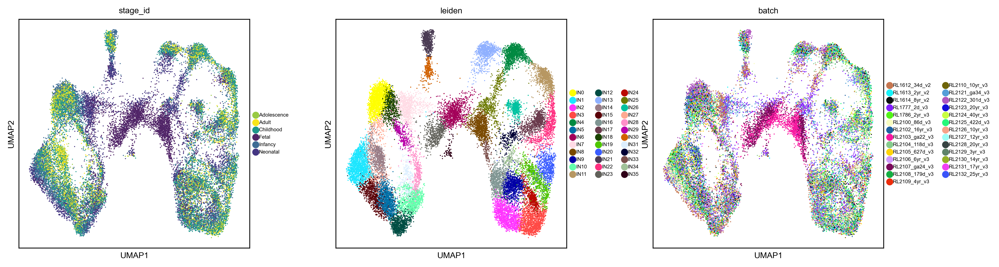

In [31]:
sc.settings.set_figure_params( dpi=200, fontsize=8)
sc.pl.umap( plt_adata_G, color=['stage_id','leiden','batch'], legend_fontsize=5, wspace=0.25)

## **Gene Overlay Plots - with full count matrix**

In [32]:
# re-calculate umi and gene counts per nuclei
sc.pp.calculate_qc_metrics( adata_GABA, percent_top=None, inplace=True)
# scale to CPM
sc.pp.normalize_total( adata_GABA, target_sum=1e6, inplace=True)
# VST
sc.pp.log1p( adata_GABA, copy=False)
# randomize order again
plt_adata_GABA = sc.pp.subsample( adata_GABA, fraction=1.0, random_state=0, copy=True) 

In [33]:
sc.settings.set_figure_params(dpi=150, fontsize=6)

def plot_show_overlays_GABA(genes, title, adata_GABA=plt_adata_GABA, pt_size=5):
    ax = sc.pl.umap(
        adata_GABA, 
        color=genes,
        size=pt_size,
        sort_order=False,
        cmap='magma',
        show=True  # Changed to show the plot instead of saving
    )
    return

Inhibitory Neruon Markers

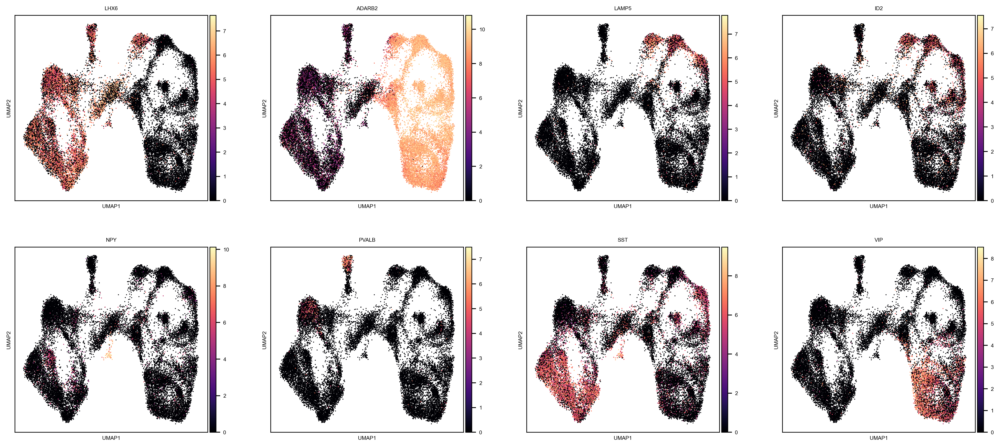

In [34]:
in_genes = ['LHX6','ADARB2','LAMP5','ID2','NPY','PVALB','SST','VIP']
plot_show_overlays_GABA( in_genes, 'IN_genes')

# ***Re-plot UMAPs***

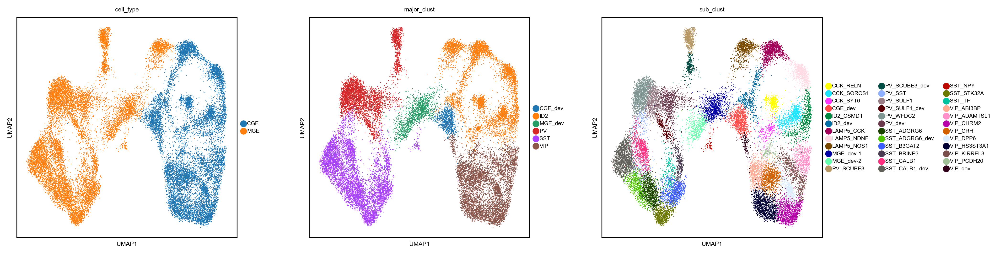

In [35]:
ax = sc.pl.umap( adata_GABA, color=['cell_type','major_clust','sub_clust'], size=2.5, sort_order=False, show=False)